In [1]:
from keras.optimizers import SGD
from keras.utils.visualize_util import plot

from convnetskeras.convnets import preprocess_image_batch, convnet
#https://github.com/heuritech/convnets-keras.git

import json, time
from keras.utils.data_utils import get_file
from keras import backend as K

imfile = 'examples/t8.jpg'  #Other good examples, t1.jpg, t4.jpg, t6.jpg, dog.jpg
im = preprocess_image_batch([imfile],img_size=(256,256), crop_size=(227,227), color_mode="rgb")

sgd = SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=True)
model = convnet('alexnet',weights_path="weights/alexnet_weights.h5", heatmap=False)
#alexnet weights: http://files.heuritech.com/weights/alexnet_weights.h5

model.compile(optimizer=sgd, loss='mse')
plot(model, to_file='model.png')

out = model.predict(im)

Using Theano backend.
Using gpu device 0: GeForce GTX 1080 (CNMeM is enabled with initial size: 75.0% of memory, cuDNN 5105)
WARNING (theano.gof.cmodule): WARNING: your Theano flags `gcc.cxxflags` specify an `-march=X` flags.
         It is better to let Theano/g++ find it automatically, but we don't do it now


In [2]:
CLASS_INDEX = None
CLASS_INDEX_PATH = 'https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json'

def decode_predictions(preds, top=5):
    global CLASS_INDEX
    if len(preds.shape) != 2 or preds.shape[1] != 1000:
        raise ValueError('`decode_predictions` expects '
                         'a batch of predictions '
                         '(i.e. a 2D array of shape (samples, 1000)). '
                         'Found array with shape: ' + str(preds.shape))
    if CLASS_INDEX is None:
        fpath = get_file('imagenet_class_index.json',
                         CLASS_INDEX_PATH,
                         cache_subdir='models')
        CLASS_INDEX = json.load(open(fpath))
    results = []
    for pred in preds:
        top_indices = pred.argsort()[-top:][::-1]
        result = [tuple(CLASS_INDEX[str(i)]) + (pred[i],) for i in top_indices]
        results.append(result)
    return results

In [26]:
len(model.layers)

34

Populating the interactive namespace from numpy and matplotlib
Layer: 0	-(None, 3, 227, 227)	:input_1
Layer: 1	-(None, 96, 55, 55)	:conv_1
Layer: 2	-(None, 96, 27, 27)	:maxpooling2d_1
Layer: 3	-(None, 96, 27, 27)	:convpool_1
Layer: 4	-(None, 96, 31, 31)	:zeropadding2d_1
Layer: 5	-(None, 48, 31, 31)	:lambda_1
Layer: 6	-(None, 48, 31, 31)	:lambda_2
Layer: 7	-(None, 128, 27, 27)	:conv_2_1
Layer: 8	-(None, 128, 27, 27)	:conv_2_2
Layer: 9	-(None, 256, 27, 27)	:conv_2
Layer: 10	-(None, 256, 13, 13)	:maxpooling2d_2
Layer: 11	-(None, 256, 13, 13)	:lambda_3
Layer: 12	-(None, 256, 15, 15)	:zeropadding2d_2
Layer: 13	-(None, 384, 13, 13)	:conv_3
Layer: 14	-(None, 384, 15, 15)	:zeropadding2d_3
Layer: 15	-(None, 192, 15, 15)	:lambda_4
Layer: 16	-(None, 192, 15, 15)	:lambda_5
Layer: 17	-(None, 192, 13, 13)	:conv_4_1
Layer: 18	-(None, 192, 13, 13)	:conv_4_2
Layer: 19	-(None, 384, 13, 13)	:conv_4
Layer: 20	-(None, 384, 15, 15)	:zeropadding2d_4
Layer: 21	-(None, 192, 15, 15)	:lambda_6
Layer: 22	-(None, 

`%matplotlib` prevents importing * from pylab and numpy


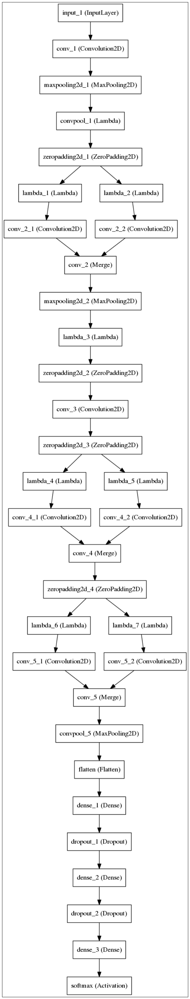

In [27]:
import matplotlib.pyplot as plt

%matplotlib inline
%pylab inline
pylab.rcParams['figure.figsize'] = (60.0, 60.0)


for i in range(0,len(model.layers)):
    print("Layer: "+str(i)+'\t-'+ str(model.layers[i].output_shape) + "\t:" + str(model.layers[i].name))
model_plt = plt.imread('model.png')
plt.imshow(model_plt)
plt.tick_params(
        axis='both',    # changes apply to both axes
        which='both',   # both major and minor ticks are affected
        bottom='off',   # ticks along the bottom edge are off
        top='off',      # ticks along the top edge are off
        labelbottom='off',
        right='off',
        left='off',
        labelleft='off') # labels along the bottom edge are off
plt.show()

In [4]:
decode_predictions(out)

[[('n02123045', 'tabby', 0.071908437),
  ('n02124075', 'Egyptian_cat', 0.063193485),
  ('n02123159', 'tiger_cat', 0.01549458),
  ('n02109961', 'Eskimo_dog', 0.014751935),
  ('n02110185', 'Siberian_husky', 0.012194525)]]

### Visualize

ImageNet ID: n02123045, Label: tabby, acc: 0.07190843671560287


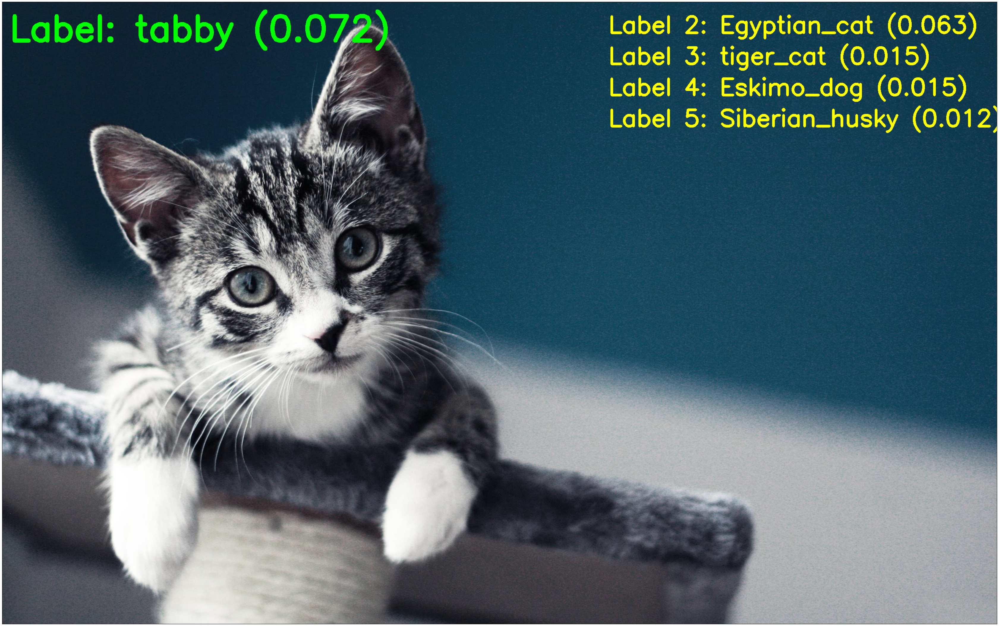

In [5]:
import cv2

orig = cv2.imread(imfile)
(inID, label, acc) = decode_predictions(out)[0][0]
print("ImageNet ID: {}, Label: {}, acc: {}".format(inID, label, acc))
cv2.putText(orig, "Label: {} ({:0.3f})".format(label,acc), (20, 100),
    cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 10);
for i in range(1,5):
    str1 = "Label {}: {} ({:0.3f})".format(i+1, decode_predictions(out)[0][i][1], decode_predictions(out)[0][i][2])
    cv2.putText(orig, str1, (orig.shape[1]-1000, 80*i),
        cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 255), 5);

orig = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)

plt.imshow(orig)
plt.tick_params(
    axis='both',    # changes apply to both axes
    which='both',   # both major and minor ticks are affected
    bottom='off',   # ticks along the bottom edge are off
    top='off',      # ticks along the top edge are off
    labelbottom='off',
    right='off',
    left='off',
    labelleft='off') # labels along the bottom edge are off
plt.show()

In [6]:
from scipy.misc import imsave

def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + 1e-5)

# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [37]:
kept_filters = []
layer_name = 'conv_5'
layer_dict = dict([(layer.name, layer) for layer in model.layers])
input_img = model.input
img_width = 227
img_height = 227
for filter_index in range(0, layer_dict[layer_name].output_shape[1],2):
    # we only scan through the first 200 filters,
    # but there are actually 512 of them
    print('Processing filter %d' % filter_index)
    start_time = time.time()

    # we build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = layer_dict[layer_name].output
    if K.image_dim_ordering() == 'th':
        loss = K.mean(layer_output[:, filter_index, :, :])
    else:
        loss = K.mean(layer_output[:, :, :, filter_index])

    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]

    # normalization trick: we normalize the gradient
    grads = normalize(grads)

    # this function returns the loss and grads given the input picture
    iterate = K.function([input_img], [loss, grads])

    # step size for gradient ascent
    step = 1.

    # we start from a gray image with some random noise
    if K.image_dim_ordering() == 'th':
        input_img_data = np.random.random((1, 3, img_width, img_height))
    else:
        input_img_data = np.random.random((1, img_width, img_height, 3))
    input_img_data = (input_img_data - 0.5) * 20 + 128

    # we run gradient ascent for 20 steps
    for i in range(20):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

        print('Current loss value:', loss_value)
        if loss_value <= 0.:
            # some filters get stuck to 0, we can skip them
            break

    # decode the resulting input image
    if loss_value > 0:
        img = deprocess_image(input_img_data[0])
        kept_filters.append((img, loss_value))
    end_time = time.time()
    print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

Processing filter 0
Current loss value: 0.0
Filter 0 processed in 5s
Processing filter 2
Current loss value: 0.05300924554467201
Current loss value: 0.16778868436813354
Current loss value: 0.5472570061683655
Current loss value: 1.143986701965332
Current loss value: 1.8465200662612915
Current loss value: 2.777214288711548
Current loss value: 4.068013668060303
Current loss value: 5.435258865356445
Current loss value: 6.962166786193848
Current loss value: 8.86606216430664
Current loss value: 10.99665641784668
Current loss value: 12.858386993408203
Current loss value: 15.330997467041016
Current loss value: 17.458606719970703
Current loss value: 19.89718246459961
Current loss value: 22.185441970825195
Current loss value: 24.64194107055664
Current loss value: 27.168519973754883
Current loss value: 30.16444206237793
Current loss value: 32.44263458251953
Filter 2 processed in 2s
Processing filter 4
Current loss value: 0.0
Filter 4 processed in 3s
Processing filter 6
Current loss value: 3.84003

In [38]:
# we will stich the best 64 filters on a 6 x 6 grid.
n = 6

# the filters that have the highest loss are assumed to be better-looking.
# we will only keep the top 36 filters.
kept_filters.sort(key=lambda x: x[1], reverse=True)
kept_filters = kept_filters[:n * n]

# build a black picture with enough space for
# our 6 x 6 filters of size 227 x 227, with a 5px margin in between
margin = 5
width = n * img_width + (n - 1) * margin
height = n * img_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img, loss = kept_filters[i * n + j]
        stitched_filters[(img_width + margin) * i: (img_width + margin) * i + img_width,
                         (img_height + margin) * j: (img_height + margin) * j + img_height, :] = img

# save the result to disk
imsave('%s_stitched_filters_%dx%d.png' % (layer_name, n, n), stitched_filters)

Populating the interactive namespace from numpy and matplotlib


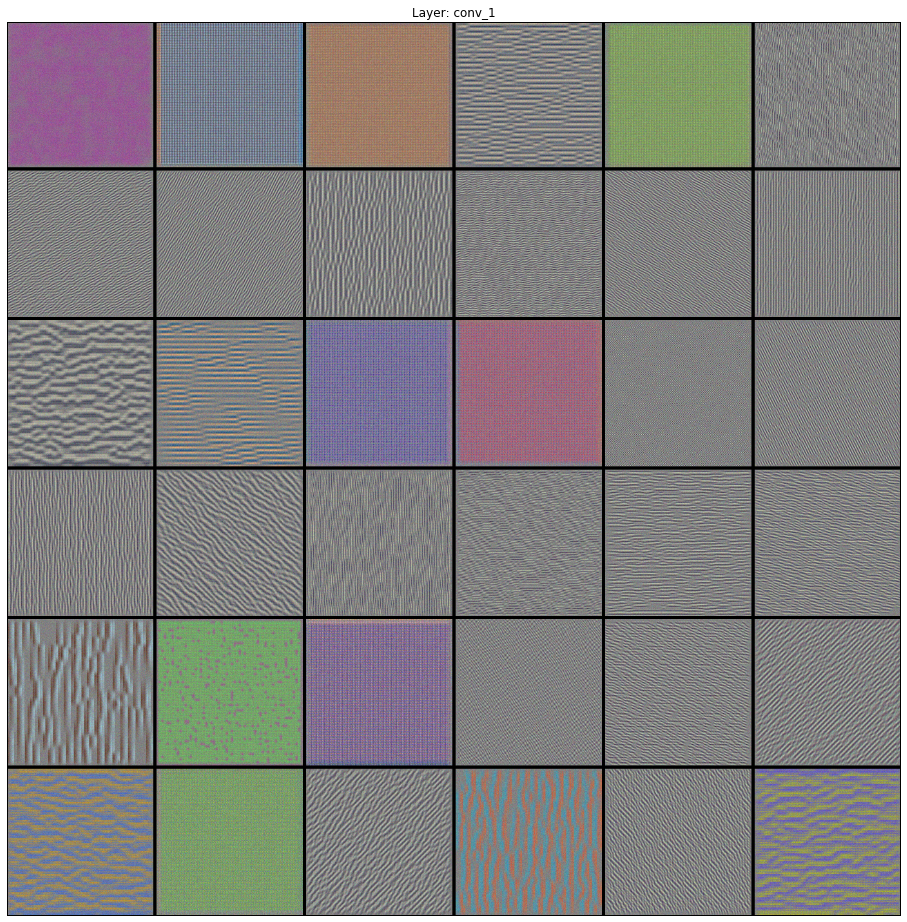

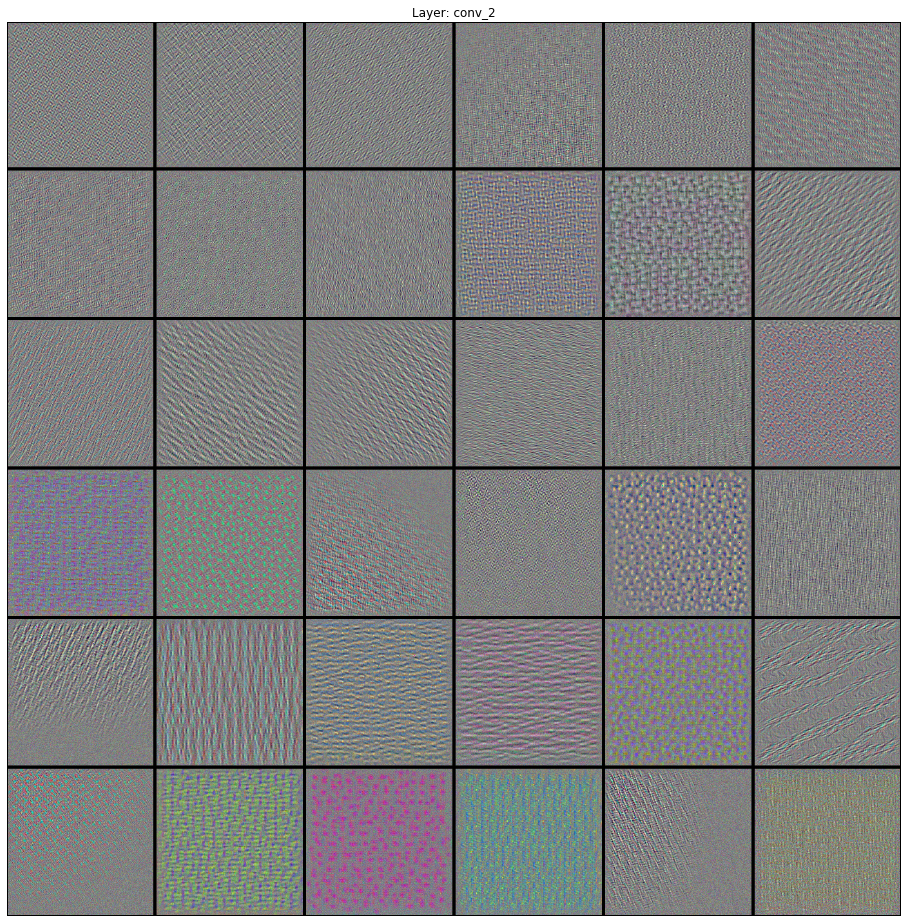

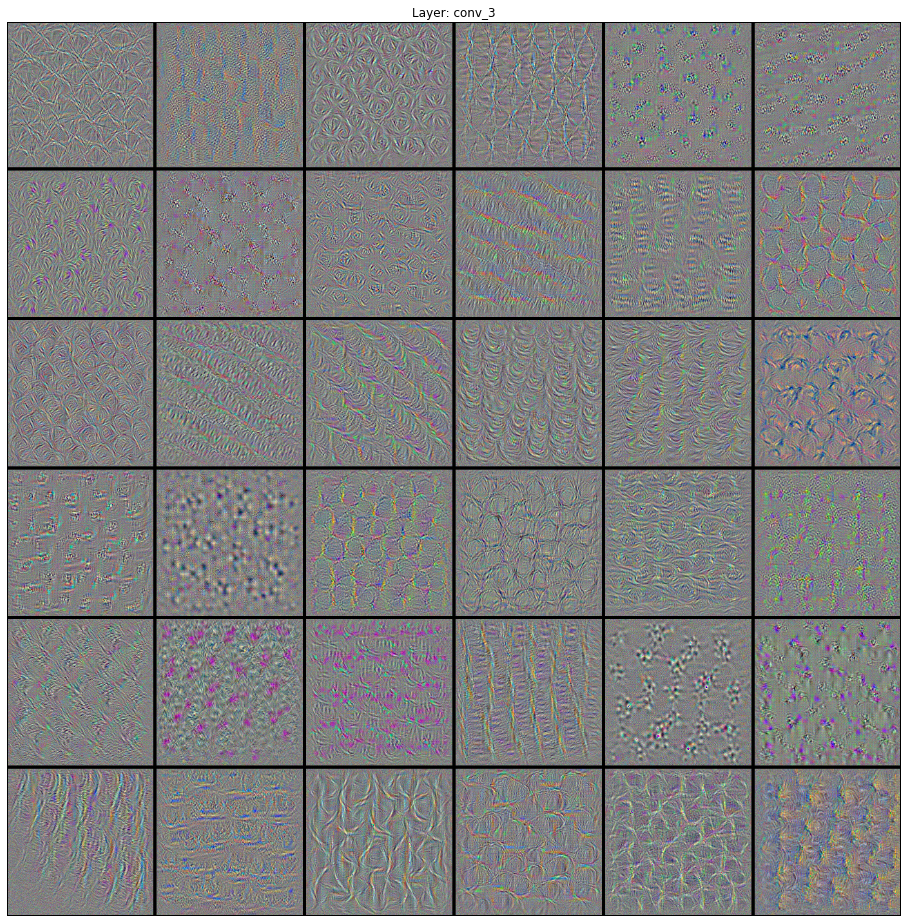

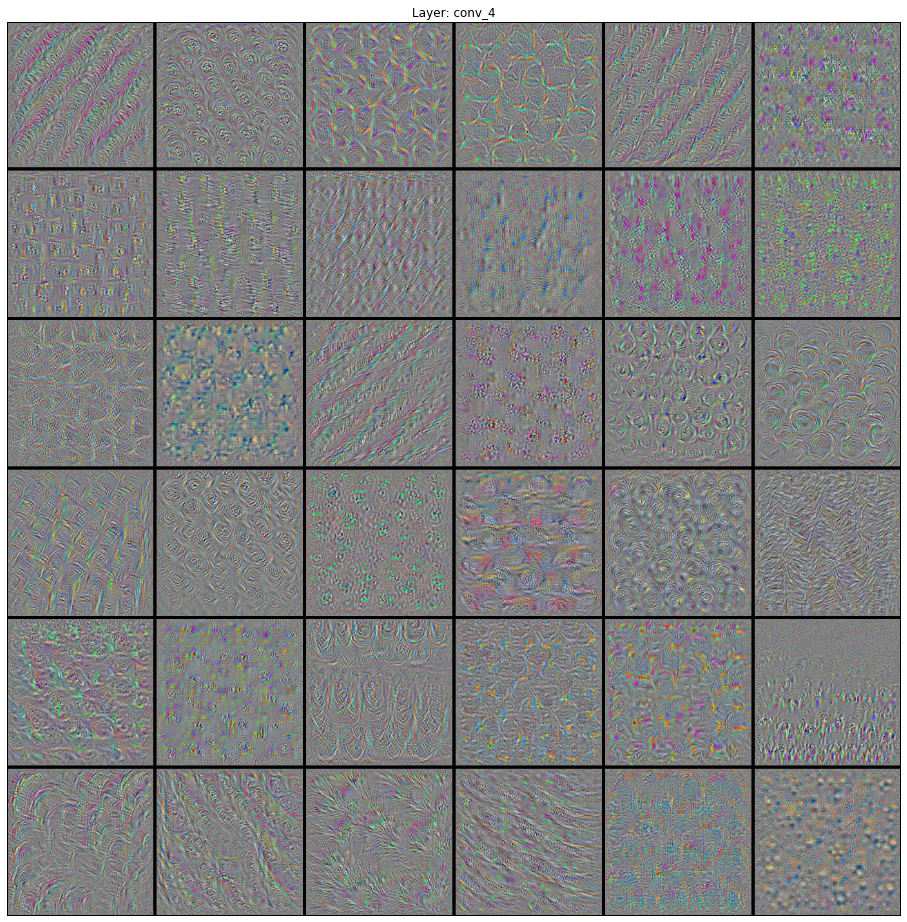

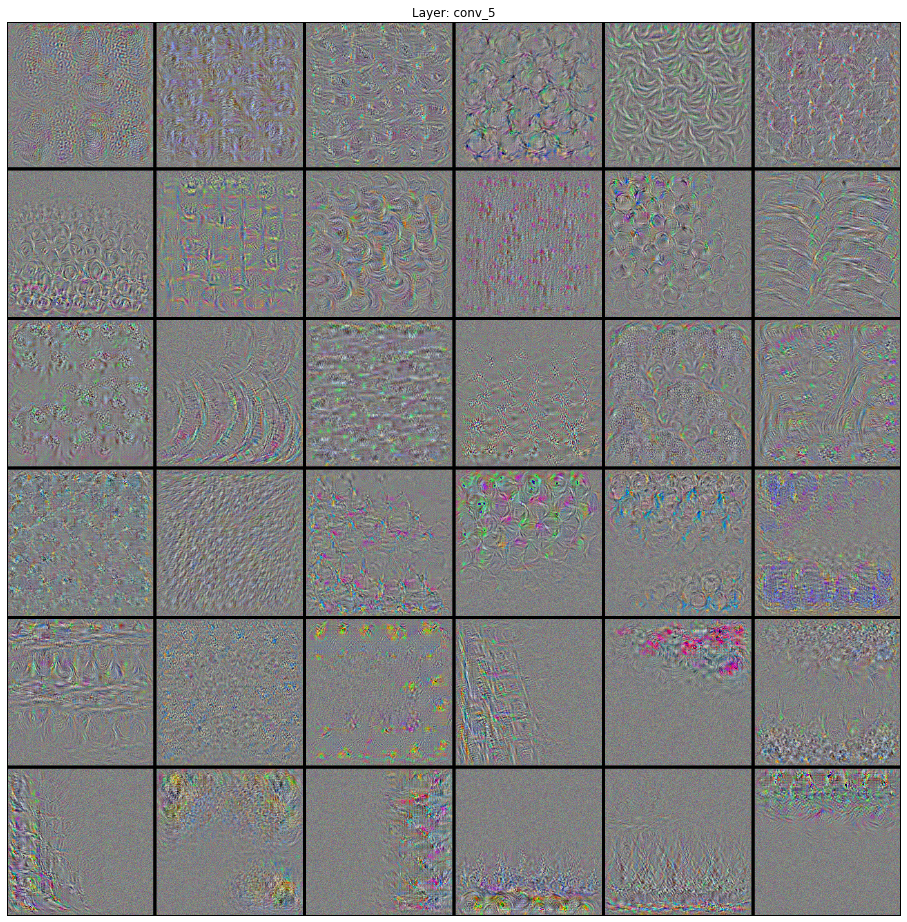

In [40]:
%matplotlib inline
%pylab inline
pylab.rcParams['figure.figsize'] = (16.0, 16.0)
layer_names = ['conv_1','conv_2','conv_3','conv_4','conv_5']

for i in range(len(layer_names)):
    imout = plt.imread('%s_stitched_filters_%dx%d.png' % (layer_names[i], n, n))
    plt.figure(i)
    plt.imshow(imout)
    plt.title("Layer: "+ layer_names[i])
    plt.tick_params(
        axis='both',    # changes apply to both axes
        which='both',   # both major and minor ticks are affected
        bottom='off',   # ticks along the bottom edge are off
        top='off',      # ticks along the top edge are off
        labelbottom='off',
        right='off',
        left='off',
        labelleft='off') # labels along the bottom edge are off
plt.show()